**Заголовок** :  Анализ оттока клиентов банка «Метанпромбанк»\
\
**Описание проекта** : Для менеджера из отдела маркетинга, подготовить презентацию, с целью помочь банку удержать существующих  клиентов. В отделе маркетинга банка нет автоматизированных систем рассылок, письма каждому клиенту пишутся вручную, поэтому важно для отдела маркетинга представить компактные однородные сегменты и дать примеры мероприятий, которые можно провести, чтобы вернуть клиентов в банк или удержать сомневающихся от оттока.

**Цель исследования**: Выяснить какие закономерности влияют и определяют отток клиентов, выделить сегменты отточных клиентов, чтобы они были однородными, высокоотточными и покрывали максимум проблемных зон банка для того, чтобы предложить мероприятия по сокращению оттока

**Ход исследования**:

**Загрузка данных и подготовка к исследованию:**

    • загрузка и изучение общей информации из предоставленного набора данных;
    • корректировка типа данных, создание дополнительных столбцов, обработка пропущенных значений и дубликатов в датафрейме;
    • классификация пропусков, нахождение взаимосвязей данных с пропусками и без, проверка на выбросы.
    

**Исследовательский анализ данных:**

    • сравнение портретов типичных клиентов отточный-лояльный (средние и медианы);
    • распределения непрерывных, в т.ч. в разрезе оттока( использовать нормализованную гистограмму);
    • уровни оттока по категориям (применить гистограммы или тепловые карты);
    • корреляционный анализ - выделение критериев и признаков отточных клиентов, для использования в дальнейшей сегментации;
    
**Проверка статистических гипотез:**

    • выдвинуть минимум две H0 гипотезы на основании поведения клиентов определить вероятность их ухода, аргументировать использование стат. теста и проверок перед тестирование;
    • влияют ли доходы на отток клиентов;
    • вторую гипотезу сформулировать исходя из сравнения типичных клиентов (после определения признаков отточных клиентов);
    
**Промежуточный итог**: о том, какие показатели стратегически влияют на отток (какие признаки стратегическим образом влияют на отток и какие значения или интервалы этих признаков связаны с оттоком)

**Сегментация на основе стратегических показателей**:

    • Выделить не мелкие, но компактные высокоотточные сегменты (минимум 3, кол-во 300-2000 человек, сегменты должны охватить 40%+ от всех отточных клиентов);
    • посчитать размер и отток сегментов;
    • приоритизация сегментов;
    • предварительные предложения по удержанию клиентов;  
    
**Общий вывод**: резюмирование полученных результатов,формулировка ключевых выводов и результатов. Предоставление конкретных мероприятий по сокращению оттока клиентов банка «Метанпромбанк»

### Шаг 1. Загрузка и подготовка к исследованию

In [1]:
import pandas as pd
import numpy as np
from datetime import datetime, timedelta
import scipy.stats as stats
from scipy import stats as st
import math as mth
import seaborn as sns
from matplotlib import pyplot as plt
import plotly.express as px

In [2]:
!pip install phik
import phik
from phik import resources, report
from phik.report import plot_correlation_matrix

In [3]:
#загружаю данные
df = pd.read_csv('https://code.s3.yandex.net/datasets/bank_scrooge.csv')
df.head(3)

,USERID,score,city,gender,age,equity,balance,products,credit_card,last_activity,EST_SALARY,churn
0,183012,850.0,Рыбинск,Ж,25.0,1,59214.82,2,0,1,75719.14,1
1,146556,861.0,Рыбинск,Ж,37.0,5,850594.33,3,1,0,86621.77,0
2,120722,892.0,Рыбинск,Ж,30.0,0,NaN,1,1,1,107683.34,0


In [4]:
#изучаю общую информацию
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 12 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   USERID         10000 non-null  int64  
 1   score          10000 non-null  float64
 2   city           10000 non-null  object 
 3   gender         10000 non-null  object 
 4   age            9974 non-null   float64
 5   equity         10000 non-null  int64  
 6   balance        7705 non-null   float64
 7   products       10000 non-null  int64  
 8   credit_card    10000 non-null  int64  
 9   last_activity  10000 non-null  int64  
 10  EST_SALARY     10000 non-null  float64
 11  churn          10000 non-null  int64  
dtypes: float64(4), int64(6), object(2)
memory usage: 937.6+ KB


In [5]:
#изучаю описание данных
df.describe()

,USERID,score,age,equity,balance,products,credit_card,last_activity,EST_SALARY,churn
count,10000.00000,10000.000000,9974.000000,10000.000000,7.705000e+03,10000.000000,10000.000000,10000.000000,1.000000e+04,10000.000000
mean,171814.71260,848.699400,42.734409,2.627600,8.277943e+05,1.870100,0.680400,0.523500,1.478669e+05,0.182000
std,33708.23812,65.448519,12.179971,1.980836,1.980614e+06,0.792647,0.466345,0.499472,1.393885e+05,0.385864
min,94561.00000,642.000000,18.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,2.546300e+03,0.000000
25%,142810.25000,802.000000,33.000000,0.000000,2.955542e+05,1.000000,0.000000,0.000000,7.525190e+04,0.000000
50%,172728.00000,853.000000,40.000000,3.000000,5.242722e+05,2.000000,1.000000,1.000000,1.196581e+05,0.000000
75%,201261.75000,900.000000,51.000000,4.000000,9.807058e+05,2.000000,1.000000,1.000000,1.745005e+05,0.000000
max,229145.00000,1000.000000,86.000000,9.000000,1.191136e+08,5.000000,1.000000,1.000000,1.395064e+06,1.000000


#### Общая информация: 
<div style="border:solid Yellow 3px; padding: 20px">
    
Датасет содержит информацию о 10000 клиентов банка\
    Присутствуют пропуски в столбцах age и balance\
    Из описания датасета можно увидеть, что средний возраст клиента - 40 лет, медиана - 33 года, аномалии выбросы отсутствуют\
    Продукты банка: максимум 5, минимум - 0, требуется проверка на корректность данных продуктов = 0.

In [6]:
#привожу к нижнему регистру названия столбцов
df = df.rename(columns=lambda x: x.lower())
df.head(3)

,userid,score,city,gender,age,equity,balance,products,credit_card,last_activity,est_salary,churn
0,183012,850.0,Рыбинск,Ж,25.0,1,59214.82,2,0,1,75719.14,1
1,146556,861.0,Рыбинск,Ж,37.0,5,850594.33,3,1,0,86621.77,0
2,120722,892.0,Рыбинск,Ж,30.0,0,NaN,1,1,1,107683.34,0


In [7]:
#кол-во пропусков в столбцах перевожу в %, сортирую по возрастанию
pd.DataFrame(round(df.isna().mean()*100,1).sort_values(ascending=False)).head(2) 

,0
balance,23.0
age,0.3


In [8]:
#фильтрую датасет, по столбцу "age"= NaN
df[df['age'].isna()].head(5)

,userid,score,city,gender,age,equity,balance,products,credit_card,last_activity,est_salary,churn
1247,228075,932.0,Ярославль,М,NaN,5,7601719.20,2,1,1,408121.16,0
2165,187635,692.0,Рыбинск,Ж,NaN,0,NaN,1,1,1,160368.82,0
2444,221156,913.0,Ярославль,М,NaN,0,NaN,1,1,1,135693.24,0
3091,138660,836.0,Ростов,Ж,NaN,5,294315.53,2,0,1,63310.22,1
4912,210674,834.0,Рыбинск,М,NaN,1,238330.52,2,0,1,93775.06,0


In [9]:
#заполняю медианными значениями строки из таблицы, по столбцу "age"= NaN, принимаю, что пропущенные значения MCAR — пропуски не зависят от переменных и не ведут к систематической ошибке 
#заполняю пропуски"age" медианой
b = df['age'].median()
df['age'] = df['age'].fillna(b)

In [10]:
#проверяю кол-во клиентов с products = 0, по условию кол-во products>1, удаляю из датасета,
#не рассматривают клиентов в дальнейшем исследовании
df[df['products']==0]
df.drop(df[(df['products']==0)].index, inplace=True)

In [11]:
#для обработки пропусков в столбце balance, создаю новый признак, принимающий 1, если в наблюдении пропущено значение признака, и 0, если в наблюдении значение признака не пропущено
df['balance_null'] = np.where(df['balance'].isna(),1,0)

In [12]:
#группирую значения по новому признаку баланса:
df_balance_null = df.groupby('balance_null')\
                .agg(cnt_userid=('userid', 'count'),mean_score=('score', 'mean'),mean_age=('age', 'mean')\
                     ,mean_equity=('equity', 'mean'),mean_est_salary=('est_salary', 'mean')\
                     ,median_est_salary=('est_salary', 'median'), mean_products=('products', 'mean'))\
                .sort_values(by = 'cnt_userid', ascending=False).reset_index()
df_balance_null

,balance_null,cnt_userid,mean_score,mean_age,mean_equity,mean_est_salary,median_est_salary,mean_products
0,0,7705,843.739260,42.920571,3.395068,124501.872366,106222.2,2.080986
1,1,2294,865.309939,42.062337,0.049695,226397.935876,174202.8,1.162598


In [13]:
#проверяю, есть ли нулевые значения баланса:
df[df['balance']==0]

,userid,score,city,gender,age,equity,balance,products,credit_card,last_activity,est_salary,churn,balance_null
3900,179831,730.0,Ярославль,М,18.0,0,0.0,2,1,1,64548.33,0,0
6757,148456,813.0,Ярославль,М,20.0,2,0.0,2,1,0,23876.51,0,0


In [14]:
#проверяю, в каких городах и были пропуски баланса, считаю количество по городам:
df_city_null = df[df['balance_null']==1]
df_city_null.groupby('city').agg(cnt_userid=('userid', 'count'))

,cnt_userid
city,
Ростов,235
Рыбинск,592
Ярославль,1467


#### Вывод по пропускам в столбце balance: 
<div style="border:solid Yellow 3px; padding: 20px">
    
1. Нулевое состояние баланса присутствует 2 раза в Ярославле, пропуски баланса были сделаны во всех города, при этом в Ярославле присутствует нулевое состояние баланса. Исключаю вариант, что пропуск - нулевое значение
    
2. Средние и медианы по оценочной з/п клиента, оценке собственности имеет сильные различия. Также кол-во пропусков составляет 23% от общего объема данных, такие пропуски относятся к типу MNAR, удалять пропуски нельзя, т.к. удаление приведет к значительным искажениям в данных, для работы требуются уточненные данные от заказчика, поэтому на данном этапе данные в датасете оставляю с пропусками.   

In [15]:
#кодирую пол клиента
df['gender_1']=df['gender']
df = pd.get_dummies(df, columns=['gender'], drop_first=True)
df

,userid,score,city,age,equity,balance,products,credit_card,last_activity,est_salary,churn,balance_null,gender_1,gender_М
0,183012,850.0,Рыбинск,25.0,1,59214.82,2,0,1,75719.14,1,0,Ж,0
1,146556,861.0,Рыбинск,37.0,5,850594.33,3,1,0,86621.77,0,0,Ж,0
2,120722,892.0,Рыбинск,30.0,0,NaN,1,1,1,107683.34,0,1,Ж,0
3,225363,866.0,Ярославль,51.0,5,1524746.26,2,0,1,174423.53,1,0,Ж,0
4,157978,730.0,Ярославль,34.0,5,174.00,1,1,0,67353.16,1,0,М,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,120553,814.0,Рыбинск,27.0,1,78144.65,1,0,1,18943.64,0,0,М,1
9996,139170,894.0,Ярославль,46.0,0,NaN,1,1,0,196898.29,0,1,М,1
9997,115639,903.0,Ярославль,24.0,0,NaN,2,1,1,108905.09,0,1,М,1
9998,148700,777.0,Ярославль,68.0,3,865457.97,3,0,1,86874.90,0,0,Ж,0


In [16]:
#смотрю сколько уникальных значений в столбце "category"
df['city'].unique()

array(['Рыбинск', 'Ярославль', 'Ростов'], dtype=object)

In [17]:
#Кодирую переменные - города. для этого создаю дублирующий столбец city1 с названиями городов
df.loc[:, 'city1'] = df.loc[:,'city']
df = pd.get_dummies(df, columns=["city1"])

In [18]:
#проверка на явные дубликаты
duplicates = df.duplicated(subset=['userid'], keep=False)
duplicated_rows = df[duplicates]
display(duplicated_rows)

,userid,score,city,age,equity,balance,products,credit_card,last_activity,est_salary,churn,balance_null,gender_1,gender_М,city1_Ростов,city1_Рыбинск,city1_Ярославль
7,218868,825.0,Ярославль,38.0,4,458145.40,2,1,1,68085.48,0,0,Ж,0,0,0,1
58,164676,860.0,Ярославль,37.0,5,648594.03,2,1,1,213586.86,1,0,М,1,0,0,1
150,185748,850.0,Рыбинск,36.0,5,1203376.67,2,0,1,89401.82,1,0,М,1,0,1,0
161,197364,928.0,Рыбинск,53.0,6,1347183.86,2,0,1,168189.49,1,0,Ж,0,0,1,0
231,190253,823.0,Рыбинск,37.0,4,373348.39,2,0,1,131947.92,1,0,М,1,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9775,124450,758.0,Рыбинск,36.0,0,73574.07,2,0,1,79963.59,0,0,Ж,0,0,1,0
9785,168998,895.0,Рыбинск,44.0,0,282653.53,3,0,0,255296.47,0,0,М,1,0,1,0
9819,140934,832.0,Рыбинск,40.0,3,385763.16,2,0,1,59651.35,0,0,Ж,0,0,1,0
9880,217412,886.0,Ярославль,35.0,3,1026172.14,2,1,0,53099.16,0,0,Ж,0,0,0,1


In [19]:
#проверка на явные дубликаты
duplicates1 = df.duplicated(subset=['userid','gender_М'], keep=False)
duplicated_rows1 = df[duplicates1]
display(duplicated_rows1)

,userid,score,city,age,equity,balance,products,credit_card,last_activity,est_salary,churn,balance_null,gender_1,gender_М,city1_Ростов,city1_Рыбинск,city1_Ярославль
7,218868,825.0,Ярославль,38.0,4,458145.40,2,1,1,68085.48,0,0,Ж,0,0,0,1
231,190253,823.0,Рыбинск,37.0,4,373348.39,2,0,1,131947.92,1,0,М,1,0,1,0
431,214031,856.0,Рыбинск,36.0,2,386426.67,4,1,1,72767.85,0,0,М,1,0,1,0
440,221197,663.0,Рыбинск,27.0,0,NaN,1,1,1,172573.13,0,1,М,1,0,1,0
690,152479,768.0,Рыбинск,42.0,0,126787.79,4,1,1,143233.23,1,0,Ж,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9632,185829,927.0,Ярославль,40.0,0,NaN,1,1,0,231254.86,0,1,М,1,0,0,1
9634,221809,917.0,Ярославль,40.0,0,NaN,1,1,1,192644.15,0,1,М,1,0,0,1
9667,163657,849.0,Ярославль,40.0,4,1254013.85,2,1,1,119106.67,0,0,М,1,0,0,1
9775,124450,758.0,Рыбинск,36.0,0,73574.07,2,0,1,79963.59,0,0,Ж,0,0,1,0


In [20]:
#точечно смотрю дубликаты
df[df['userid']==218868]

,userid,score,city,age,equity,balance,products,credit_card,last_activity,est_salary,churn,balance_null,gender_1,gender_М,city1_Ростов,city1_Рыбинск,city1_Ярославль
7,218868,825.0,Ярославль,38.0,4,458145.40,2,1,1,68085.48,0,0,Ж,0,0,0,1
5470,218868,827.0,Рыбинск,40.0,4,448959.07,2,1,1,67835.95,0,0,Ж,0,0,1,0


In [21]:
#точечно смотрю дубликаты
df[df['userid']==190253]

,userid,score,city,age,equity,balance,products,credit_card,last_activity,est_salary,churn,balance_null,gender_1,gender_М,city1_Ростов,city1_Рыбинск,city1_Ярославль
231,190253,823.0,Рыбинск,37.0,4,373348.39,2,0,1,131947.92,1,0,М,1,0,1,0
1583,190253,726.0,Ярославль,49.0,0,NaN,1,1,1,177700.78,0,1,М,1,0,0,1


#### Вывод по дубликатам: 
<div style="border:solid Yellow 3px; padding: 20px">
    
1. Найдено 146 дубликатов userid, среди них одинаковый gender у 82 дубликатов, города у дубликатов разные, что может говорить, что разным людям в разных городах могут назначать одинаковые userid

In [22]:
#рассмотрю выбросы на возможность удаления в разрезе отточных и постянных клиентов
fig = px.box(df, x = 'churn', y = 'balance',
             
       title = 'Баланс на счёте', 
       template = 'ggplot2',
       color = 'churn'
       )
fig.update_xaxes(categoryorder='total ascending')
fig.update_layout(xaxis_title = 'Отточный клиент(1)/нет (0)',
                  yaxis_title = 'Сумма',
                 showlegend=False)

In [23]:
#считаю кол-во отточных и постоянных клиентов
df['churn'].value_counts()

0    8180
1    1819
Name: churn, dtype: int64

In [24]:
#считаю кол-во клиентов в датасете с балансом более 40млн 
print('Кол-во клиентов в датасете с балансом более 40млн -', df['userid'][(df['balance']>40000000)].count())
print('Кол-во отточных клиентов с балансом более 40млн -',df['userid'][(df['balance']>40000000)&(df['churn']==1)].count())


Кол-во клиентов в датасете с балансом более 40млн - 3
Кол-во отточных клиентов с балансом более 40млн - 1


In [25]:
#удаляю из датасета клиентов с балансом более 40млн уе,
df.drop(df[(df['balance']>40000000)].index, inplace=True)

#### Вывод по клиентам с балансом более 40 млн: 
<div style="border:solid Yellow 3px; padding: 20px">
    
1. В датасете всего 3 клиента имеют баланас более 40млн, из них 1 отточный клиент, количесво клиентов менее 1% от общего числа клиентов, принимаю таких клиентов за выбросы и удаляю из датасета, для продолжения дальнейшего исследования

In [26]:
#рассмотрю выбросы на возможность удаления в разрезе отточных и постянных клиентов
fig = px.box(df, x = 'churn', y = 'est_salary',
             
       title = 'Заработная плата клиента', 
       template = 'ggplot2',
       color = 'churn'
       )
fig.update_xaxes(categoryorder='total ascending')
fig.update_layout(xaxis_title = 'Отточный клиент(1)/нет (0)',
                  yaxis_title = 'Сумма',
                 showlegend=False)

In [27]:
#меняю типы мтолбцов age и score на int
df['age'] = df['age'].astype('int')
df['score'] = df['score'].astype('int')

In [28]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9996 entries, 0 to 9999
Data columns (total 17 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   userid           9996 non-null   int64  
 1   score            9996 non-null   int32  
 2   city             9996 non-null   object 
 3   age              9996 non-null   int32  
 4   equity           9996 non-null   int64  
 5   balance          7702 non-null   float64
 6   products         9996 non-null   int64  
 7   credit_card      9996 non-null   int64  
 8   last_activity    9996 non-null   int64  
 9   est_salary       9996 non-null   float64
 10  churn            9996 non-null   int64  
 11  balance_null     9996 non-null   int32  
 12  gender_1         9996 non-null   object 
 13  gender_М         9996 non-null   uint8  
 14  city1_Ростов     9996 non-null   uint8  
 15  city1_Рыбинск    9996 non-null   uint8  
 16  city1_Ярославль  9996 non-null   uint8  
dtypes: float64(2),

#### Вывод по п.1: 
<div style="border:solid Yellow 3px; padding: 20px">
    
Я изучила датасет, удалила явные дубликаты .
Всего в датасете для дальнейших расчетов осталось 9996 клиентов
   
Заменила пропуски в столбце "age" медианой, пропуски в столбце "balance" оставила без изменений,\
в связи с тем что кол-во пропусков составляет 23% от общего объема данных и удаление или изменение таких пропусков может привести к искаженным расчетам\
Закодировала переменные - "city", создала столбцы "city1_Ростов", "city1_Рыбинск", "city1_Ярославль" для дальнейшего анализа портрета клиента в разрезе городов\
Нашла 146 дубликатов userid, среди них одинаковый gender у 82 дубликатов, города у дубликатов разные, что может говорить, что разным людям в разных городах могут назначать одинаковые userid. Дубликаты оставила без изменений

### Шаг 2. Исследовательский анализ данных:

#### Сравнение портретов типичных клиентов

In [29]:
#добавила столбец с категорией клиентов
def churn_status(churn): 
    if churn==1: 
        return 'Отточный клиент'
    else: return 'Постоянный клиент'

df['churn_status'] = df['churn'].apply(churn_status)

In [30]:
pivot2 = pd.pivot_table(df, index=['churn_status'],\
                       values=['userid'],\
                       aggfunc={'userid':'count'}).reset_index() 
pivot2

,churn_status,userid
0,Отточный клиент,1818
1,Постоянный клиент,8178


In [31]:
#строю круговую диаграмму
fig = px.pie(df, values='userid', names='churn_status', title='Кол-во отточных и постоянных клиентов')
fig.show()

In [32]:
#рассматриваю оттточных и постоянных клиентов в разрезе данных из датасета, определяю разницу между данными:
pivot = pd.pivot_table(df, index=['churn_status'],\
                       values=['age','balance','est_salary','score','equity','products','last_activity'],\
                       aggfunc={'age':'median','balance':{'mean','median'},'est_salary':{'mean','median'}\
                                ,'score':{'mean','median'},'equity':{'mean','median'}\
                                ,'products':{'mean','median'},'last_activity':{'mean','median'}}).reset_index() 
pivot

churn_status    age       balance                equity         \
                     median          mean      median      mean median   
0    Отточный клиент   39.0  1.098704e+06  781540.965  3.764026    4.0   
1  Постоянный клиент   40.0  7.066890e+05  475352.420  2.374175    3.0   

      est_salary             last_activity         products         \
            mean      median          mean median      mean median   
0  148343.428493  125408.880      0.702420    1.0  2.377338    2.0   
1  147792.359571  118257.715      0.483615    0.0  1.757398    2.0   

        score         
         mean median  
0  863.330033  866.0  
1  845.411714  848.0

##### Вывод по пункту: сравнение портретов отточных и лояльных  клиентов: 
<div style="border:solid Yellow 3px; padding: 20px">
  
1. В датасете отточные клиенты составляют 18,1%, постоянные клиенты - 81,9%
    
2. Портрет отточных клиентов:\
    'age' - 39 л.\
    'balance' - 781 тыс. уе;\
    'equity'(оценка собственности) - 4;\
    'est_salary' - 125 тыс. уе;\
    'products' - 2;\
    'score'(кредитные баллы) = 866;
    
3. Портрет лояльных клиентов:\
    'age' - 40 л.\
    'balance' - 475 тыс. уе;\
    'equity'(оценка собственности) - 3;\
    'est_salary' - 118 тыс. уе;\
    'products' - 2;\
    'score'(кредитные баллы) = 848;
     

#### Распределение дискретных признаков в разрезе оттока 

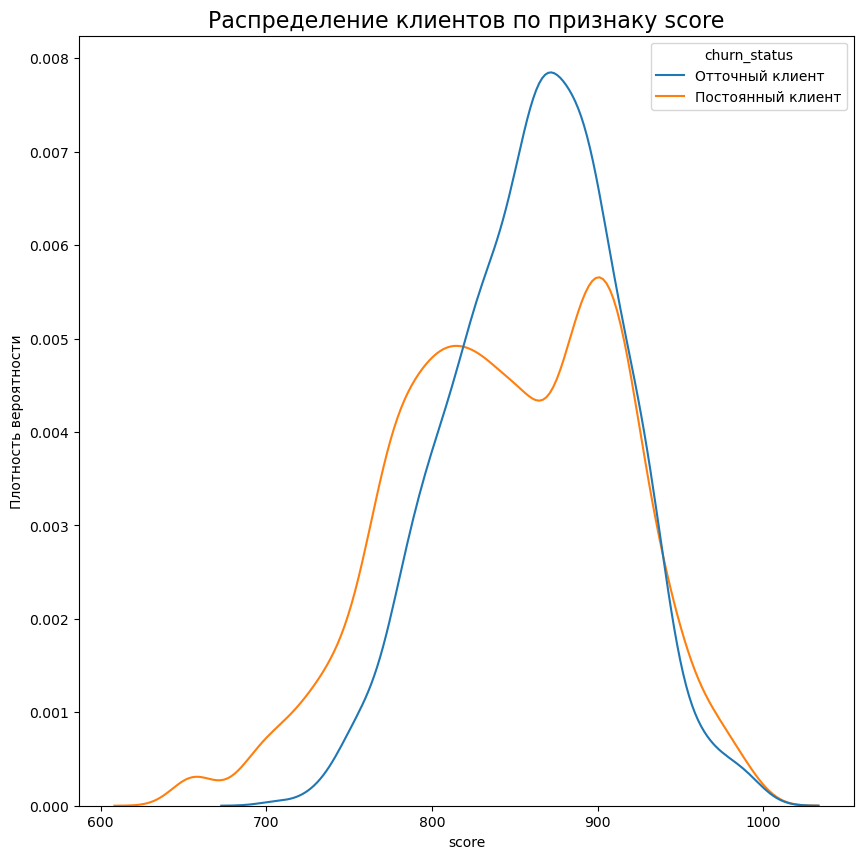

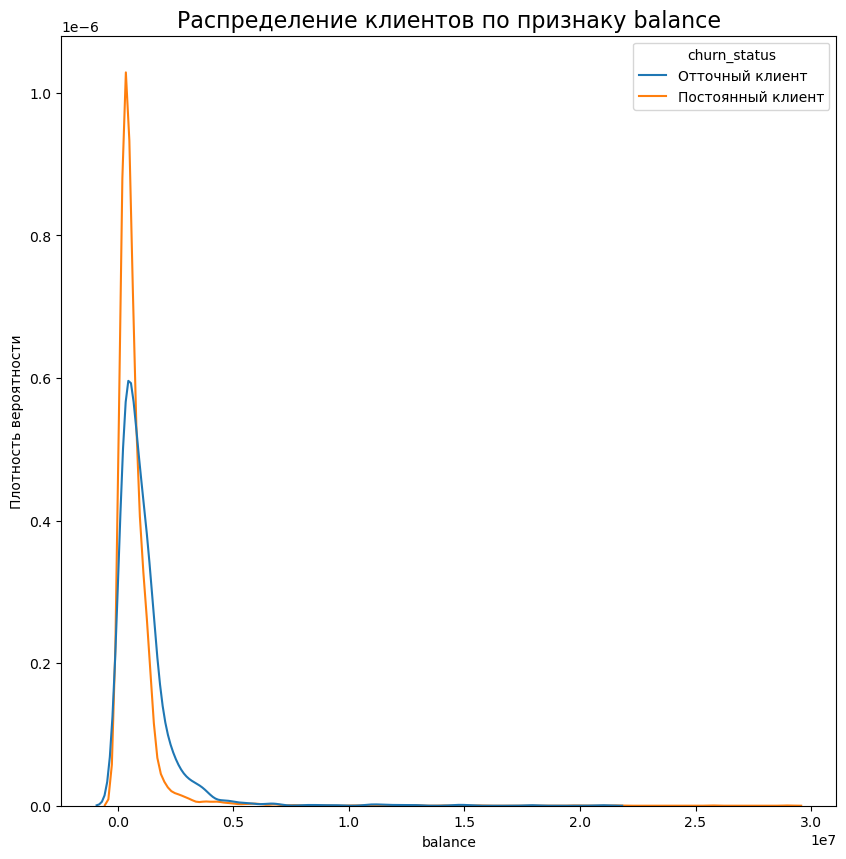

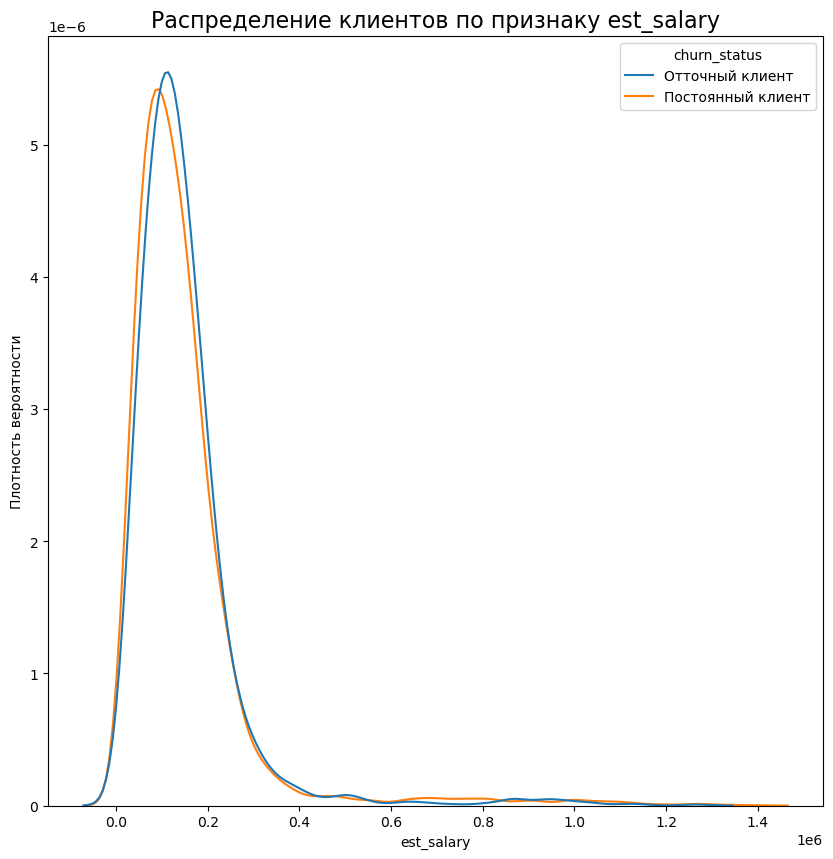

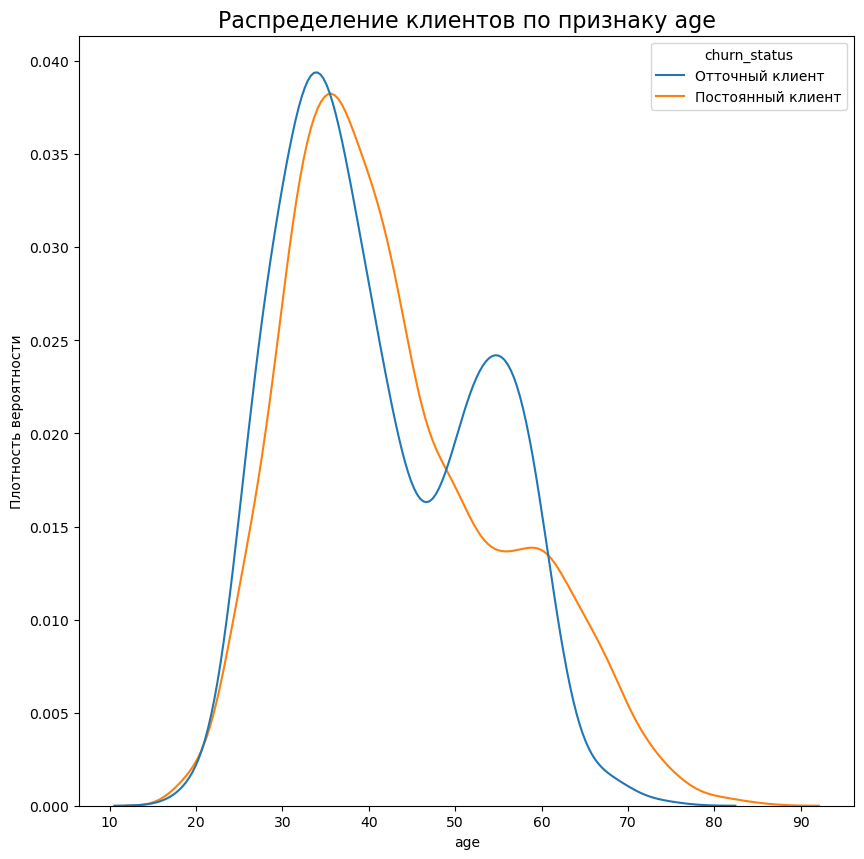

In [33]:
#создаю функцию для формирования графиков распределения через нормированную гистограмму для дискретных признаков:
def hist1(df):
    for column in ['score', 'balance', 'est_salary', 'age']:
        plt.figure(figsize=(10, 10))
        sns.kdeplot(data=df, x=column,hue='churn_status', common_norm=False, );
        plt.title(f'Распределение клиентов по признаку {column}', fontsize = 16)
        plt.ylabel('Плотность вероятности')
        plt.show()
hist1(df)    

In [34]:
#создаю функцию для формирования графиков распределения через нормированную гистограмму для дискретных признаков:
def hist2(df):
    for column in ['score', 'balance', 'est_salary', 'age']:
           fig = px.histogram(df, x=column, histnorm='probability density'\
                           ,color='churn_status',title = f'Распределение клиентов по признаку {column}'\
                           ,barnorm='percent',barmode ='overlay')
           fig.update_layout(yaxis_title='Плотность распределения')
           fig.show()
hist2(df) 

##### Дополнительное исследование по дискретным признакам клентов: 
<div style="border:solid Yellow 3px; padding: 20px">
  
Необходимо построить более крупные графики по балансу 'balance' и доходу 'est_salary'

In [35]:
#строю график распределения через нормированную гистограмму для датасена, с ограничением баланса до 7млн
print('Кол-во клиентов в датасете с балансом более 7млн -', df['userid'][(df['balance']>7000000)].count())
print('Кол-во отточных клиентов с балансом более 7млн -',df['userid'][(df['balance']>7000000)&(df['churn']==1)].count())
df_balance = df[(df['balance']<7000000)]
fig_b = px.histogram(df_balance, x='balance', histnorm='probability density'\
                           ,color='churn_status',title = 'Распределение клиентов по признаку balance'\
                           ,barnorm='percent',barmode ='overlay')
fig_b.update_layout(yaxis_title='Плотность распределения')
fig_b.show()

Кол-во клиентов в датасете с балансом более 7млн - 32
Кол-во отточных клиентов с балансом более 7млн - 13


In [36]:
#строю график распределения через нормированную гистограмму для датасена, с ограничением дохода до 700 тыс у.е
print('Кол-во клиентов в датасете с балансом более 700тыс -', df['userid'][(df['est_salary']>700000)].count())
print('Кол-во отточных клиентов с балансом более 700тыс -',df['userid'][(df['est_salary']>700000)&(df['churn']==1)].count())
df_salary = df[(df['est_salary']<700000)]
fig_s = px.histogram(df_salary, x='est_salary', histnorm='probability density'\
                           ,color='churn_status',title = 'Распределение клиентов по признаку est_salary'\
                           ,barnorm='percent',barmode ='overlay')
fig_s.update_layout(yaxis_title='Плотность распределения')
fig_s.show()

Кол-во клиентов в датасете с балансом более 700тыс - 178
Кол-во отточных клиентов с балансом более 700тыс - 23


##### Вывод по дискретным признакам клентов: 
<div style="border:solid Yellow 3px; padding: 20px">
  
Признаки отточных клиентов:\
    'score'(кредитные баллы) = 820-909;\
    'balance' - 725K-825K, 925К - 1,25М, 1,125M - 2,675М, 2,725М - 3,825М;\
    'est_salary' - 75K - 85K, 100K - 135K, 145K - 165K, 170K - 180K, 185K - 190K, 190K - 215K, 225K - 235K, 290K - 305K, 325K - 330K,  395K - 415K\
    'age' - по возрасту наблюдается два скачка: 50-60 лет, 25-35 года      

#### Уровни оттока по категориям

In [37]:
#добавляю текстовую категорию для credit_card
def credit_card(credit_card):
    for row in df['credit_card']:
        if credit_card == 1:
            return 'Есть кредитная карта'
        if credit_card == 0:
            return 'Нет кредитной карты'
            
df['credit_card_text'] = df['credit_card'].apply(credit_card)

In [38]:
#добавляю текстовую категорию для last_activity
def last_activity(last_activity):
    for row in df['last_activity']:
        if last_activity == 1:
            return 'Активный клиент'
        if last_activity == 0:
            return 'Неактивный клиент'
            
df['last_activity_text'] = df['last_activity'].apply(last_activity)

In [39]:
#группирую значения по оттоку в разрезе городов, определяю разницу между данными:
pivot1 = pd.pivot_table(df, index=['churn_status','city'],\
                       values=['userid'],\
                       aggfunc={'userid':'count'}).reset_index() 
pivot1['prcnt_city']=0
for name in ['Ростов', 'Рыбинск', 'Ярославль']:
    pivot1.loc[pivot1['city']==name,['prcnt_city']] = round(pivot1[pivot1['city']==name]['userid'] / pivot1[pivot1['city']==name]['userid'].sum() * 100,2)
    pivot1
pivot1

,churn_status,city,userid,prcnt_city
0,Отточный клиент,Ростов,266,18.77
1,Отточный клиент,Рыбинск,436,16.18
2,Отточный клиент,Ярославль,1116,18.96
3,Постоянный клиент,Ростов,1151,81.23
4,Постоянный клиент,Рыбинск,2258,83.82
5,Постоянный клиент,Ярославль,4769,81.04


In [40]:
#группирую значения по оттоку в разрезе активности клиента, определяю разницу между данными:
pivot1 = pd.pivot_table(df, index=['churn_status','last_activity_text'],\
                       values=['userid'],\
                       aggfunc={'userid':'count'}).reset_index() 
pivot1['prcnt_activity']=0
for name in ['Активный клиент', 'Неактивный клиент']:
    pivot1.loc[pivot1['last_activity_text']==name,['prcnt_activity']] = round(pivot1[pivot1['last_activity_text']==name]['userid'] / pivot1[pivot1['last_activity_text']==name]['userid'].sum() * 100,2)
    pivot1
pivot1

,churn_status,last_activity_text,userid,prcnt_activity
0,Отточный клиент,Активный клиент,1277,24.41
1,Отточный клиент,Неактивный клиент,541,11.36
2,Постоянный клиент,Активный клиент,3955,75.59
3,Постоянный клиент,Неактивный клиент,4223,88.64


In [41]:
#группирую значения по оттоку в разрезе наличия кредитной карты, определяю разницу между данными:
pivot1 = pd.pivot_table(df, index=['churn_status','credit_card_text'],\
                       values=['userid'],\
                       aggfunc={'userid':'count'}).reset_index() 
pivot1['prcnt_credit_card']=0
for name in ['Есть кредитная карта','Нет кредитной карты']:
    pivot1.loc[pivot1['credit_card_text']==name,['prcnt_credit_card']] = round(pivot1[pivot1['credit_card_text']==name]['userid'] / pivot1[pivot1['credit_card_text']==name]['userid'].sum() * 100,2)
    pivot1
pivot1

,churn_status,credit_card_text,userid,prcnt_credit_card
0,Отточный клиент,Есть кредитная карта,1002,14.73
1,Отточный клиент,Нет кредитной карты,816,25.55
2,Постоянный клиент,Есть кредитная карта,5800,85.27
3,Постоянный клиент,Нет кредитной карты,2378,74.45


In [42]:
#группирую значения по оттоку в разрезе кол-ва продуктов банка, определяю разницу между данными:
pivot1 = pd.pivot_table(df, index=['churn_status','products'],\
                       values=['userid'],\
                       aggfunc={'userid':'count'}).reset_index() 
pivot1['prcnt_products']=0
for name in (1,2,3,4,5):
    pivot1.loc[pivot1['products']==name,['prcnt_products']] = round(pivot1[pivot1['products']==name]['userid'] / pivot1[pivot1['products']==name]['userid'].sum() * 100,2)
    pivot1
pivot1

,churn_status,products,userid,prcnt_products
0,Отточный клиент,1,235,7.03
1,Отточный клиент,2,978,19.09
2,Отточный клиент,3,297,28.61
3,Отточный клиент,4,300,63.29
4,Отточный клиент,5,8,42.11
5,Постоянный клиент,1,3106,92.97
6,Постоянный клиент,2,4146,80.91
7,Постоянный клиент,3,741,71.39
8,Постоянный клиент,4,174,36.71
9,Постоянный клиент,5,11,57.89


In [43]:
#группирую значения по оттоку в разрезе кол-ва продуктов банка, определяю разницу между данными:
pivot1 = pd.pivot_table(df, index=['churn_status','equity'],\
                       values=['userid'],\
                       aggfunc={'userid':'count'}).reset_index() 
pivot1['prcnt_equity']=0
for name in range(9):
    pivot1.loc[pivot1['equity']==name,['prcnt_equity']] = round(pivot1[pivot1['equity']==name]['userid'] / pivot1[pivot1['equity']==name]['userid'].sum(),2)
    pivot1
pivot1

,churn_status,equity,userid,prcnt_equity
0,Отточный клиент,0,90,0.03
1,Отточный клиент,1,93,0.12
2,Отточный клиент,2,166,0.16
3,Отточный клиент,3,321,0.21
4,Отточный клиент,4,463,0.25
5,Отточный клиент,5,577,0.30
6,Отточный клиент,6,58,0.36
7,Отточный клиент,7,37,0.46
8,Отточный клиент,8,6,0.35
9,Отточный клиент,9,7,0.00


In [44]:
#группирую значения по оттоку в разрезе наличия кредитной карты, определяю разницу между данными:
pivot1 = pd.pivot_table(df, index=['churn_status','gender_1'],\
                       values=['userid'],\
                       aggfunc={'userid':'count'}).reset_index() 
pivot1['prcnt_gender_1']=0
for name in ['Ж','М']:
    pivot1.loc[pivot1['gender_1']==name,['prcnt_gender_1']] = round(pivot1[pivot1['gender_1']==name]['userid'] / pivot1[pivot1['gender_1']==name]['userid'].sum() * 100,2)
    pivot1
pivot1

,churn_status,gender_1,userid,prcnt_gender_1
0,Отточный клиент,Ж,636,12.74
1,Отточный клиент,М,1182,23.63
2,Постоянный клиент,Ж,4358,87.26
3,Постоянный клиент,М,3820,76.37


In [45]:
#создаю функцию для формирования графиков распределения через гистограмы для категориальных признаков:
def hist3(df):
    for column in ['city','last_activity_text', 'credit_card_text', 'gender_1', 'equity', 'products']:
        fig = px.histogram(df, x=column, histnorm='probability density'\
                           ,color='churn_status',title = f'Распределение клиентов по категориальному признаку {column}'\
                           ,barnorm='percent',barmode ='overlay')
        fig.update_layout(yaxis_title='Плотность распределения')
        fig.show()
hist3(df)

##### Вывод по категориальным признакам: 
<div style="border:solid Yellow 3px; padding: 20px">
    
Категориальные признаки отточных клиентов:
1. 'city' - отточные клиенты составляют 16% - 18% от всех клиентов в разрезе каждого города;
2. 'last_activity' - Активный клиент- 24.41%, Неактивный клиент- 11.36%
3. 'products' - от 2 до 5 продуктов банка, 63.29% отточных клиентов имеют 4 продукта банка, 42% клиентов - 5 продуктов банка;
4. 'credit_card' - Есть кредитная карта	- 14.73%, Нет кредитной карты -25.55%;
5. 'equity' - от 0 до 9 оценка собственности, максимальное количество отточных клиентов имеют оценку  от 5 до 8 (5-30%, 6-36%, 7-46%, 8-35%;
6. 'gender_М' - мужчина, составляют 23% от всех мужчин датасета, 12,74% - женщин отточные клиенты, среди всех женщин датасета

    
Категориальные признаки лояльных клиентов:
1. 'city' - лояльные клиенты составляют более 80% от всех клиентов в разрезе города;
2. 'last_activity' - неактивный клиент - 88%, Активный клиент- 75%,
3. 'products' - от 2 до 5 продуктов банка, 93% отточных клиентов имеют 1 продукт банка, 81% клиентов - 2 продукта банка, 71% - 3 продукта;
4. 'credit_card' - Есть кредитная карта	- 85%, Нет кредитной карты - 75%;
5. 'gender_М' - мужчина, составляют 87% от всех мужчин датасета, 76% - женщин отточные клиенты, среди всех женщин датасета

    


#### Корреляционный анализ

In [46]:
df_corr = df.copy()
df_corr.drop(['userid', 'gender_1', 'balance_null','churn_status', 'credit_card_text', 'last_activity_text','city'], axis=1, inplace=True)
df_corr.head()

,score,age,equity,balance,products,credit_card,last_activity,est_salary,churn,gender_М,city1_Ростов,city1_Рыбинск,city1_Ярославль
0,850,25,1,59214.82,2,0,1,75719.14,1,0,0,1,0
1,861,37,5,850594.33,3,1,0,86621.77,0,0,0,1,0
2,892,30,0,NaN,1,1,1,107683.34,0,0,0,1,0
3,866,51,5,1524746.26,2,0,1,174423.53,1,0,0,0,1
4,730,34,5,174.00,1,1,0,67353.16,1,1,0,0,1


In [47]:
phik = df_corr.phik_matrix()
pd.set_option('display.float_format', '{:.0%}'.format)
phik

interval columns not set, guessing: ['score', 'age', 'equity', 'balance', 'products', 'credit_card', 'last_activity', 'est_salary', 'churn', 'gender_М', 'city1_Ростов', 'city1_Рыбинск', 'city1_Ярославль']


,score,age,equity,balance,products,credit_card,last_activity,est_salary,churn,gender_М,city1_Ростов,city1_Рыбинск,city1_Ярославль
score,100%,3%,53%,32%,42%,21%,5%,40%,23%,7%,9%,3%,8%
age,3%,100%,5%,3%,14%,16%,9%,36%,19%,29%,7%,6%,9%
equity,53%,5%,100%,10%,58%,22%,5%,29%,35%,6%,7%,0%,5%
balance,32%,3%,10%,100%,10%,10%,2%,73%,11%,8%,4%,3%,7%
products,42%,14%,58%,10%,100%,27%,11%,22%,26%,7%,5%,8%,11%
credit_card,21%,16%,22%,10%,27%,100%,5%,4%,20%,20%,15%,8%,18%
last_activity,5%,9%,5%,2%,11%,5%,100%,5%,26%,2%,0%,8%,8%
est_salary,40%,36%,29%,73%,22%,4%,5%,100%,5%,15%,14%,10%,18%
churn,23%,19%,35%,11%,26%,20%,26%,5%,100%,22%,0%,5%,3%
gender_М,7%,29%,6%,8%,7%,20%,2%,15%,22%,100%,2%,2%,4%


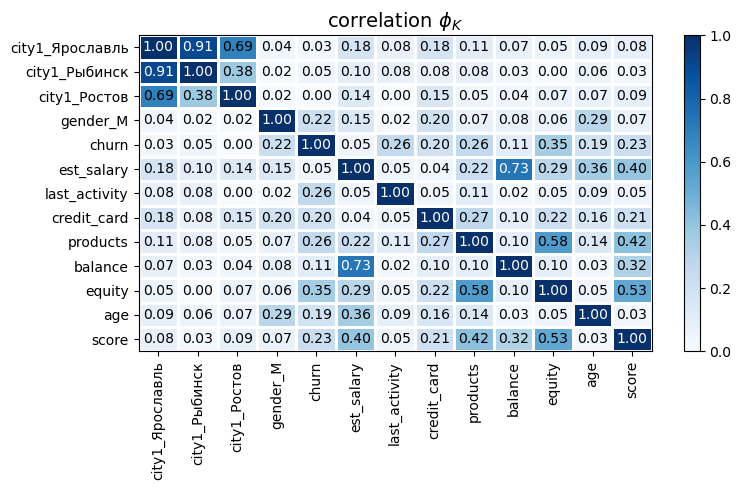

In [48]:
plot_correlation_matrix(phik.values, 
                        x_labels=phik.columns, 
                        y_labels=phik.index, 
                        vmin=0, vmax=1, color_map="Blues", 
                        title=r"correlation $\phi_K$", 
                        fontsize_factor=1, 
                        figsize=(8, 5))
plt.tight_layout()

##### Вывод по корреляционному анализу: 
<div style="border:solid Yellow 3px; padding: 20px">
    
При выполнении корреляционного анализа,  наблюдается умеренная связь между churn и equity (0,35), также наблюдается слабая связь между churn и products (0,26), между churn и last_activity (0,26), между churn и score(0,23), между churn и credit_card(0,20), между churn и gender_М(0,22)

<Axes: >

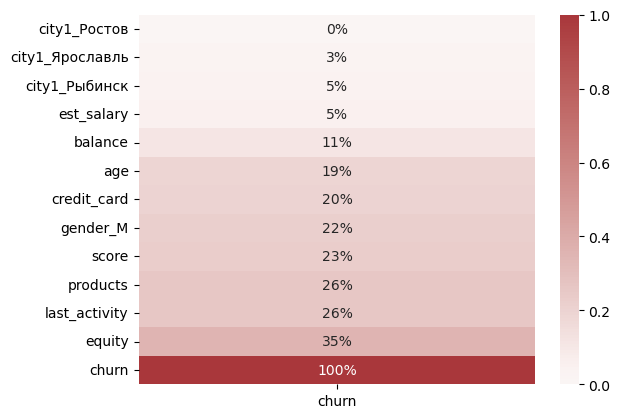

In [49]:
#выделиа корреляцию по столбцу 'churn'
sns.heatmap(phik.loc[:,['churn']].sort_values('churn'),annot=True, fmt='.0%', cmap='vlag', center=0)

#### Вывод по п.2 Исследовательский анализ данных: 
<div style="border:solid Yellow 3px; padding: 20px">
    
1. В датасете отточные клиенты составляют 18,1%, постоянные клиенты - 81,9%
    

2. Лояльные клиенты:
    
2.1. Портрет лояльных клиентов:\
    'age' - 40 л.\
    'balance' - 475 тыс. уе;\
    'equity'(оценка собственности) - 3;\
    'est_salary' - 118 тыс. уе;\
    'products' - 2;\
    'score'(кредитные баллы) = 848;
    
2.2  Категориальные признаки лояльных клиентов:
 1. 'city' - лояльные клиенты составляют более 80% от всех клиентов в разрезе города;
 2. 'last_activity' - неактивный клиент - 88%, Активный клиент- 75%,
 3. 'products' - от 2 до 5 продуктов банка, 93% отточных клиентов имеют 1 продукт банка, 81% клиентов - 2 продукта банка, 71% -   3 продукта;
 4. 'credit_card' - Есть кредитная карта	- 85%, Нет кредитной карты - 75%;
 5. 'equity' - максимальное количество отточных клиентов имеют оценку  от 1 до ;
 6. 'gender_М' - мужчина, составляют 87% от всех мужчин датасета, 76% - женщин отточные клиенты, среди всех женщин датасета. 

    
3.. Отточные клиенты:    
    
3.1. Портрет отточных клиентов:\
    'age' - 39 л.\
    'balance' - 781 тыс. уе;\
    'equity'(оценка собственности) - 4;\
    'est_salary' - 125 тыс. уе;\
    'products' - 2;\
    'score'(кредитные баллы) = 866;
    
3.2 Признаки отточных клиентов:\
    'score'(кредитные баллы) = 820-909;\
    'balance' - 725K-825K, 925К - 1,25М, 1,125M - 2,675М, 2,725М - 3,825М;\
    'est_salary' - 75K - 85K, 100K - 135K, 145K - 165K, 170K - 180K, 185K - 190K, 190K - 215K, 225K - 235K, 290K - 305K, 325K - 330K,  395K - 415K\
    'age' - по возрасту наблюдается два скачка: 50-60 лет, 25-35 года       
    
3.3   Категориальные признаки отточных клиентов:
1. 'city' - отточные клиенты составляют 16% - 18% от всех клиентов в разрезе каждого города;
2. 'last_activity' - Активный клиент- 24.41%, Неактивный клиент- 11.36%
3. 'products' - от 2 до 5 продуктов банка, 63.29% отточных клиентов имеют 4 продукта банка, 42% клиентов - 5 продуктов банка;
4. 'credit_card' - Есть кредитная карта	- 14.73%, Нет кредитной карты -25.55%;
5. 'equity' - от 3 до 9 оценка собственности, максималое количество отточных клметов имеют оценку  от 3 до 5 (3-20.82%, 4-25.04%, 5-30.11%;
6. 'gender_М' - мужчина, составляют 23% от всех мужчин датасета, 12,74% - женщин отточные клиенты, среди всех женщин датасета
  
3.4 При выполнении корреляционного анализа,  наблюдается умеренная связь между churn и equity (0,35), также наблюдается слабая связь между churn и products (0,26), между churn и last_activity (0,26), между churn и score(0,23), между churn и credit_card(0,20), между churn и gender_М(0,22)
    
**Вывод:**
    При сравнении лояльных и отточных клиентов важно обратить внимание, что значение 'balance' у отточных клментов на 306 тыс.уе больше медианного значения лояльных клиентов. 'score'(кредитные баллы) у отточных клиентов на 18 пунктов больше медианного значения лояльных клиентов.Также важно обратить внимание, что больше 60% отточных клиентов пользуются 4 продуктами банка, а 42% отточных клиентов пользуются 5 продуктами

### Шаг 3. Проверка статистических гипотез:

#### Проверить гипотезу: Есть ли значимая разница в доходах между клиентами, которые уходят, и теми, что остаются.
Ho = Статистически значимых различий в доходах между отточными и лояльными клиентами нет.\
H1 = Статистически значимые различия в доходах между отточными и лояльными клиентами есть.

Принимаю alpha = 5%
Для проверки гипотез будет использоваться метод А/В тестирования, проверка критерием Манна-Уитни

**Проверка нулевой гипотезы t-критерием Стьюдента**\
Условия для применения t-теста:
1. Генеральные совокупности не зависят друг от друга.
2. Выборочные средние нормально распределены. 
3. Дисперсии рассматриваемых генеральных совокупностей равны.
4. Выборки достаточно велики (30 и больше значений)

In [52]:
#собираю в новые датафреймы, не зависящие друг от труга, генеральные совокупности (отточные клиенты и постоянные клиенты)
salary1 = df['est_salary'][df['churn'] == 0]
salary2 = df['est_salary'][df['churn'] == 1]

In [53]:
#считаю кол-во значений в выборках
print('Размер выборки по з/п постоянных клиентов -',salary1.count())
print('Размер выборки по з/п отточных клиентов -',salary2.count())

Размер выборки по з/п постоянных клиентов - 8178
Размер выборки по з/п отточных клиентов - 1818


In [54]:
salary1.describe()

count      817800%
mean     14779236%
std      14281798%
min        254630%
25%       7349516%
50%      11825772%
75%      17401222%
max     139506445%
Name: est_salary, dtype: float64

In [55]:
salary2.describe()

count      181800%
mean     14834343%
std      12294025%
min       1088027%
25%       8315808%
50%      12540888%
75%      17601784%
max     126302849%
Name: est_salary, dtype: float64

In [56]:
#проверяю равенство средних значений двух выборок:
print(f'Относительная разница средних значений двух выборок -', round(100 - salary1.mean()/salary2.mean()*100,2),'%')

Относительная разница средних значений двух выборок - 0.37 %


##### Вывод по распределению выборочных средних: 
<div style="border:solid Yellow 3px; padding: 20px">
Так как размер выборки составляет более тысячи значений, то выборочные средние, которые можно получить из одной и той же генеральной совокупности, будут распределены близко к нормальному вокруг истинного среднего этой совокупности

Равенство средних значений двух выборок отличается меньше чем на 1%

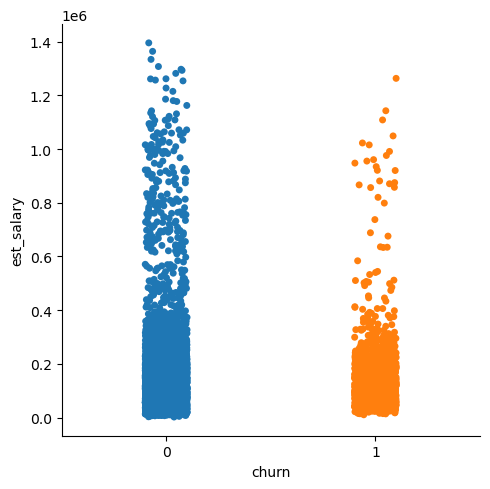

In [57]:
#рассматриваю дисперсии генеральных совокупностей::
sns.catplot(y='est_salary', x='churn', hue='churn', data=df);
plt.show()

In [58]:
#строю диаграмму размаха
fig = px.box(df, x = 'churn_status', y = 'est_salary',    
       title = 'Распределение est_salary по типам клиентов', 
       template = 'ggplot2',
       color = 'churn'
       )
fig.update_xaxes(categoryorder='median ascending')
fig.update_layout(xaxis_title = 'Тип клиента',
                  yaxis_title = 'Доходы клиента',
                 showlegend=False)

**На графике наблюдается большое количество выбросов, удаляю выбросы для проведения теста**

In [59]:
#Расчет 95-й и 99-й перцентили з\п клиентов. Выбор границы для определения аномальной з\п
print(np.percentile(df['est_salary'], [90, 95, 99]))

[242401.99   316886.4025 888043.513 ]


##### Вывод по границам для определения аномальной з\п: 
<div style="border:solid Yellow 3px; padding: 20px">
Расчет 95-й и 99-й перцентили показал, что не более 5% з\п клиентов составляет более 316 тыс, и не более 1% з\п клиентов - 888 тыс. Можно принять, что з\п клиентов 316 тыс и более - аномальное значение

In [60]:
#удаляю выбросы по 95 перцентили, проверяю перцентили после удаления выбросов
df_salary = df[(df['est_salary']<316000)]
print(np.percentile(df_salary['est_salary'], [90, 95, 99]))

[213884.72  243859.15  291329.461]


In [61]:
#строю диаграмму размаха после удаления выбросов
fig = px.box(df_salary, x = 'churn_status', y = 'est_salary',    
       title = 'Распределение est_salary по типам клиентов', 
       template = 'ggplot2',
       color = 'churn'
       )
fig.update_xaxes(categoryorder='median ascending')
fig.update_layout(xaxis_title = 'Тип клиента',
                  yaxis_title = 'Доходы клиента',
                 showlegend=False)

##### Вывод по границам для определения аномальной з\п после удаления выбросов:
<div style="border:solid Yellow 3px; padding: 20px">
Наблюдаю на графике выбросы. Принимаю решение удалить выбросы по 99-й перцентили - 291 тыс

In [62]:
#удаляю выбросы по 95 перцентили, проверяю перцентили после удаления выбросов
df_salary = df[(df['est_salary']<291000)]
print(np.percentile(df_salary['est_salary'], [90, 95, 99]))

[209744.16  236194.855 274897.333]


In [63]:
#строю диаграмму размаха после удаления выбросов
fig = px.box(df_salary, x = 'churn_status', y = 'est_salary',    
       title = 'Распределение est_salary по типам клиентов', 
       template = 'ggplot2',
       color = 'churn'
       )
fig.update_xaxes(categoryorder='median ascending')
fig.update_layout(xaxis_title = 'Тип клиента',
                  yaxis_title = 'Доходы клиента',
                 showlegend=False)

In [64]:
df_salary_exit = df_salary[df_salary['churn']==1] 
df_salary_enter = df_salary[df_salary['churn']==0] 

In [65]:
#проверка нулевой гипотезы t-критерием Стьюдента по очищенным данным
group1 = df_salary_exit['est_salary']
group2 = df_salary_enter['est_salary']
alpha = 0.05 
results = stats.ttest_ind(group1,group2, alternative='greater')
if results.pvalue < alpha:
    print('Отвергаем нулевую гипотезу')
    print('pvalue =', results.pvalue)
else:
    print('Не удалось отвергнуть нулевую гипотезу')
    print('pvalue =', results.pvalue)

Отвергаем нулевую гипотезу
pvalue = 9.07109456056002e-05


##### Вывод по гипотезе по очищенным данным: Статистически значимых различий в доходах между отточными и лояльными клиентами нет, проверка t-критерием
<div style="border:solid Yellow 3px; padding: 20px">
Статистически значимых различий в доходах между отточными и лояльными клиентами есть

In [66]:
#проверка нулевой гипотезы t-критерием Стьюдента с данными с выбросами
df_exit = df[df['churn']==1] 
df_enter = df[df['churn']==0] 
alpha = 0.05 
results = stats.ttest_ind(df_exit['est_salary'],df_enter['est_salary'], alternative='greater')
if results.pvalue < alpha:
    print('Отвергаем нулевую гипотезу')
    print('pvalue =', results.pvalue)
else:
    print('Не удалось отвергнуть нулевую гипотезу')
    print('pvalue =', results.pvalue)

Не удалось отвергнуть нулевую гипотезу
pvalue = 0.43942081745857314


##### Вывод по гипотезе по данным с выбросами: Статистически значимых различий в доходах между отточными и лояльными клиентами нет, проверка t-критерием
<div style="border:solid Yellow 3px; padding: 20px">
Статистически значимых различий в доходах между отточными и лояльными клиентами нет.

#### Проверить гипотезу: Есть ли значимая разница в доходах между клиентами, которые уходят, и теми, что остаются., проверка u-критерием
Ho = Статистически значимых различий в доходах между отточными и лояльными клиентами нет.\
H1 = Статистически значимые различия в доходах между отточными и лояльными клиентами есть

Принимаю alpha = 5%
Для проверки гипотез будет использоваться метод А/В тестирования, проверка критерием Манна-Уитни


In [67]:
#проверка нулевой гипотезы u-критерием Манна-Уитни с данными с выбросами
alpha = 0.05 
results = st.mannwhitneyu(df_exit['est_salary'],df_enter['est_salary'])
if results.pvalue < alpha:
    print('Отвергаем нулевую гипотезу')
    print('pvalue =', results.pvalue)
else:
    print('Не удалось отвергнуть нулевую гипотезу')
    print('pvalue =', results.pvalue)

Отвергаем нулевую гипотезу
pvalue = 0.00020267731104008386


In [68]:
#проверка нулевой гипотезы u-критерием Манна-Уитни по очищенным данным
alpha = 0.05 
results = st.mannwhitneyu(group1,group2)
if results.pvalue < alpha:
    print('Отвергаем нулевую гипотезу')
    print('pvalue =', results.pvalue)
else:
    print('Не удалось отвергнуть нулевую гипотезу')
    print('pvalue =', results.pvalue)

Отвергаем нулевую гипотезу
pvalue = 1.2995895368509358e-05


##### Вывод по гипотезам: сравнение гипотез u-критерием Манна-Уитни и t-критерием Стьюдента
<div style="border:solid Yellow 3px; padding: 20px">
    
**Статистически значимые различия в доходах клиентов между группами есть**
        
Т-критерий - параметрический тест, предполагающий нормальное распределение и равные дисперсии, используемый для сравнения средних значений двух групп, поэтому выбросы сильно влиют на результат. u-критерием Манна-Уитни — это непараметрический тест, и он более устойчив к выбросам. В нашем случае u-критерием Манна-Уитни показал одинаковый результат при выпослении теста с выбросами и без, и напротив t-критерием Стьюдента оказался неуствойчив к выбросам

#### Проверить гипотезу: Есть ли значимая разница в оценке собственности между клиентами, которые уходят, и теми, что остаются, проверка u-критерием;
Ho = Статистически значимых различий в оценке собственности между отточными и лояльными клиентами нет\
H1 = Статистически значимые различия в оценке собственности между отточными и лояльными клиентами есть.

Принимаю alpha = 5%
Для проверки гипотез будет использоваться метод А/В тестирования, проверка критерием Манна-Уитни


In [69]:
#строю диаграмму размаха
fig = px.box(df, x = 'churn_status', y = 'equity',    
       title = 'Распределение equity по типам клиентов', 
       template = 'ggplot2',
       color = 'churn'
       )
fig.update_xaxes(categoryorder='median ascending')
fig.update_layout(xaxis_title = 'Тип клиента',
                  yaxis_title = 'Доходы клиента',
                 showlegend=False)

In [70]:
#проверка нулевой гипотезы u-критерием Манна-Уитни по очищенным данным
df_equity_exit = df[df['churn']==1] 
df_equity_enter = df[df['churn']==0] 
group3 = df_equity_exit['equity']
group4 = df_equity_enter['equity']
alpha = 0.05 
results = st.mannwhitneyu(group3,group4)
if results.pvalue < alpha:
    print('Отвергаем нулевую гипотезу')
    print('pvalue =', results.pvalue)
else:
    print('Не удалось отвергнуть нулевую гипотезу')
    print('pvalue =', results.pvalue)

Отвергаем нулевую гипотезу
pvalue = 1.697792448181875e-158


##### Вывод по гипотезе: Статистически значимых различий в оценке собственности между отточными и лояльными клиентами нет
<div style="border:solid Yellow 3px; padding: 20px">
Статистически значимые различия в оценке собственности между отточными и лояльными клиентами есть

#### Проверить гипотезу: Есть ли значимая разница в оценке кредитных баллов между клиентами, которые уходят, и теми, что остаются, проверка u-критерием;
Ho = Статистически значимых различий в оценке кредитных баллов клиентов между группами нет\
H1 = Статистически значимых различий в оценке кредитных баллов клиентов между группами есть.

Принимаю alpha = 5%
Для проверки гипотез будет использоваться метод А/В тестирования, проверка критерием Манна-Уитни    

In [71]:
#строю диаграмму размаха
fig = px.box(df, x = 'churn_status', y = 'score',    
       title = 'Распределение score по типам клиентов', 
       template = 'ggplot2',
       color = 'churn'
       )
fig.update_xaxes(categoryorder='median ascending')
fig.update_layout(xaxis_title = 'Тип клиента',
                  yaxis_title = 'Доходы клиента',
                 showlegend=False)

In [72]:
#смотрю персентили
print(np.percentile(df['score'], [25, 95, 99]))

[802.   945.25 978.  ]


In [73]:
#удаляю выбросы
df_score = df[df['score'] > 800]
df_score = df_score[df_score['score'] < 945]
print('Отточный клиент', df_score[df_score['churn']==1].shape[0])
print('Постоянный клиент', df_score[df_score['churn']==0].shape[0])

Отточный клиент 1539
Постоянный клиент 5499


In [74]:
#строю диаграмму размаха по очищенным данным
fig = px.box(df_score, x = 'churn_status', y = 'score',    
       title = 'Распределение score по типам клиентов', 
       template = 'ggplot2',
       color = 'churn'
       )
fig.update_xaxes(categoryorder='median ascending')
fig.update_layout(xaxis_title = 'Тип клиента',
                  yaxis_title = 'Доходы клиента',
                 showlegend=False)

In [75]:
#проверка нулевой гипотезы u-критерием Манна-Уитни по очищенным данным
df_score_exit = df_score[df_score['churn']==1] 
df_score_enter = df_score[df_score['churn']==0] 
alpha = 0.05 
results = st.mannwhitneyu(df_score_exit['score'],df_score_enter['score'])
if results.pvalue < alpha:
    print('Отвергаем нулевую гипотезу')
    print('pvalue =', results.pvalue)
else:
    print('Не удалось отвергнуть нулевую гипотезу')
    print('pvalue =', results.pvalue)

Не удалось отвергнуть нулевую гипотезу
pvalue = 0.7643244895360607


In [76]:
df_equity_exit = df[df['churn']==1] 
df_equity_enter = df[df['churn']==0] 
group3 = df_equity_exit['score']
group4 = df_equity_enter['score']
alpha = 0.05 
results = st.mannwhitneyu(group3,group4)
if results.pvalue < alpha:
    print('Отвергаем нулевую гипотезу')
    print('pvalue =', results.pvalue)
else:
    print('Не удалось отвергнуть нулевую гипотезу')
    print('pvalue =', results.pvalue)

Отвергаем нулевую гипотезу
pvalue = 7.3300597925015215e-22


##### Вывод по гипотезе: Статистически значимых различий в оценке кредитных баллов между отточными и лояльными клиентами нет
<div style="border:solid Yellow 3px; padding: 20px">
Статистически значимые различия в оценке кредитных баллов между отточными и лояльными клиентами есть.

### Шаг 4. Промежуточный итог: критерии, на основании которых я буду строить сегменты

    4.1. 'score' - баллы кредитного скоринга: 820-909.
    Гипотеза о том, что баллы кредитного скоринга клиента влияют на отток клиентов подтвердилась
    4.2. 'equity'(оценка собственности) - 3-5 (3-20.82%, 4-25.04%, 5-30.11%);
    Корреляция с 'churn' = 0,35
    Гипотеза о том, что оценка собственности клиента влияет на отток клиентов - не подтвердилась.
    4.3. 'balance' - 725K-825K, 925К - 1,25М, 1,125M - 2,675М, 2,725М - 3,825М;
    4.4.'est_salary' - 75K - 85K, 100K - 135K, 145K - 165K, 170K - 180K, 185K - 190K
    4.5. 'last_activity' отточных клиентов = Активный клиент- 24.41%
    Корреляция с 'churn' = 0,26
    4.6. 'age' - внаблюдается два скачка: 50-60 лет, 25-35 года;
    4.7. 'products' - 63.29% отточных клиентов имеют 4 продукта банка, 42% клиентов - 5 продуктов банка;
    Корреляция с 'churn' = 0,26
    4.8. 'gender_М' - мужчина, составляют 23% от всех мужчин датасета, 12,74% - женщин отточные клиенты, среди всех женщин датасета
    Корреляция с 'churn' = 0,22
    4.9. 'credit_card' - Есть кредитная карта - 14.73%, Нет кредитной карты -25.55%;
    Корреляция с 'churn' = 0,20

In [77]:
#выделяю первый сегмент: активные клиенты в возрасте от 32 до 37 лет,
#с количеством продуктов банка менее 2, с оценкой собственности 4,5
print('Кол-во клиентов в первом сегменте -',df.query( 'last_activity==1 & age > 31 & age < 38 & products < 3 & equity > 3 & equity < 6').shape[0])
df_sgmnt2 = df.query( 'last_activity==1 & age > 31 & age < 38 & products < 3 & equity > 3 & equity < 6' )\
                .agg({"churn":["sum","count"], "balance":["mean","median"], "products":["mean"],\
                    "score":["mean","median"]})
print('Уровень оттока -',round(df_sgmnt2['churn'][0]/df_sgmnt2['churn'][1]*100,2))
df_sgmnt2

Кол-во клиентов в первом сегменте - 352
Уровень оттока - 41.76


,churn,balance,products,score
sum,14700%,NaN,NaN,NaN
count,35200%,NaN,NaN,NaN
mean,NaN,119856984%,180%,85588%
median,NaN,74052545%,NaN,85300%


In [78]:
#выделяю второй сегмент: клиенты мужчины, с оценкой собственности 4,5
#и высокими баллами кредитного скоринга от 820 до 900
print('Кол-во клиентов во втором сегменте -',df.query( 'equity > 3 & equity < 6 & score > 820 & score < 900 & gender_М ==1' ).shape[0])
df_sgmnt1 = df.query( 'equity > 3 & equity < 6 & score > 820 & score < 900 & gender_М ==1')\
                .agg({"churn":["sum","count"],"balance":["mean","median"], "products":["mean"],\
                     "equity":["mean","median"], "age":["mean","median"]})
print('Уровень оттока -',round(df_sgmnt1['churn'][0]/df_sgmnt1['churn'][1]*100,2))
df_sgmnt1

Кол-во клиентов во втором сегменте - 937
Уровень оттока - 40.02


,churn,balance,products,equity,age
sum,37500%,NaN,NaN,NaN,NaN
count,93700%,NaN,NaN,NaN,NaN
mean,NaN,94901016%,219%,455%,4067%
median,NaN,74144805%,NaN,500%,3900%


In [79]:
#выделяю третий сегмент: активные клиенты в возрасте от 50 до 59 лет
print('Кол-во клиентов в третьем сегменте -',df.query( 'last_activity==1 & score > 800 & score < 950 & age > 49 & age < 60' ).shape[0])
df_sgmnt3 = df.query( 'last_activity==1 & score > 800 & score < 950 & age > 49 & age < 60' )\
                .agg({"churn":["sum","count"], "balance":["mean","median"], "products":["mean"],\
                     "equity":["mean","median"], "score":["mean","median"]})
print('Уровень оттока -',round(df_sgmnt3['churn'][0]/df_sgmnt3['churn'][1]*100,2))
df_sgmnt3

Кол-во клиентов в третьем сегменте - 585
Уровень оттока - 41.2


,churn,balance,products,equity,score
sum,24100%,NaN,NaN,NaN,NaN
count,58500%,NaN,NaN,NaN,NaN
mean,NaN,102856742%,200%,294%,86863%
median,NaN,77308827%,NaN,300%,86900%


#### Вывод сегментации на основе стратегических показателей:
<div style="border:solid Yellow 3px; padding: 20px">
Я выделила 3 основных сегмента клиентов для дальнейшей работы с оттоками в данных сегментах, распределение сегментов в соответсвии с приоритетами:
    
    1. Активные клиенты в возрасте от 32 до 37 лет, с количеством продуктов банка менее 2, с оценкой собственности 4,5
    
    2. Клиенты мужчины, с оценкой собственности 4,5 и высокими баллами кредитного скоринга от 820 до 900
    
    3. Активные клиенты в возрасте от 50 до 59 лет, с баллами кредитного скоринга от 800 до 950
    

### Шаг 6. Методы по удержанию клиентов:

#### Методы по удержанию клиентов в разрезе каждого сегмента:
<div style="border:solid Yellow 3px; padding: 20px">
    
    1. Активные клиенты в возрасте от 32 до 37 лет, с количеством продуктов банка менее 2, с оценкой собственности 4,5
    По статистике в возрасте от 32 до 37 лет люди впервые задумываются о том, как начать копить на пенсию и какие способы в мире существуют. С учетом трендов на инвестиции, можно предложить открыть брокерский счет или с учетов высокой ставки - предлагать короткие вклады под высокие проценты.
    
    2. Клиенты мужчины, с оценкой собственности 4,5 и высокими баллами кредитного скоринга от 820 до 900
    Оценка собственности говорит о наличие имущества, высоки кредитный балл говорит о положительной кредитной истории и финансовой грамотности. Для мужской части клиентов можно предлагать разные виды страховок: ОСАГО, КАСКО, ипотечное страхование, страхование путешественников.
    
    3. Активные клиенты в возрасте от 50 до 59 лет, с баллами кредитного скоринга от 800 до 950:
    Клиенты относятся к предпенсионному возрасту, таким клиентом можно предложить автоматическую форму справки по расчету пенсии, предлагать продукты "накопления пенсии" - долгосрочные вклады. Также важно сделать акцент на здоровье - предолжить страхование здоровья. Еще можно предложить поставить автоматическое напоминание о диспансеризации клиента с перечнем варчей необходимых к посещению.
    

### Шаг 7. Общий вывод:

#### Общий вывод по проекту: Анализ оттока клиентов банка «Метанпромбанк»
<div style="border:solid Yellow 3px; padding: 20px">
    
С целью помочь банку удержать существующих клиентов, я подготовила презентацию для менеджера из отдела маркетинга. На этапе сегментации выделила 3 сегмента клиентов с уровнем оттока более 40%, а также предложила для каждого сегмента мероприятия по сокращению оттока.
    
Для выполнения данной работы, я провела исследование предоставленного датасета.
    
В ходе исследования:
    
    1. я подготовила данные к исследованию: данные были предоставлены по 10 тыс клиентов, после удаления явных дубликатов  в датасете для прооведения дальнейших расчетов осталось 9996 клиентов. Заменила пропуски в столбце "age" медианой, пропуски в столбце "balance" оставила без изменений,в связи с тем что кол-во пропусков составляет 23% от общего объема данных и удаление или изменение таких пропусков может привести к искаженным расчетам. Закодировала переменные - "city", создала столбцы "city1_Ростов", "city1_Рыбинск", "city1_Ярославль" для дальнейшего анализа портрета клиента в разрезе городов. Нашла 146 дубликатов userid, среди них одинаковый gender у 82 дубликатов, города у дубликатов разные, что может говорить, что разным людям в разных городах могут назначать одинаковые userid. Дубликаты оставила без изменений.
    
    2. вторым этапом было проведение исследовательского анализа данных: исследование показало, что отточные клиенты составляют 18,1%, постоянные клиенты - 81,9%
    
    1. Лояльные клиенты:
    Портрет лояльных клиентов:
    'age' - 40 л.
    'balance' - 475 тыс. уе;
    'equity'(оценка собственности) - 3;
    'est_salary' - 118 тыс. уе;
    'products' - 2;
    'score'(кредитные баллы) = 848;

    Категориальные признаки лояльных клиентов:

    'city' - лояльные клиенты составляют более 80% от всех клиентов в разрезе города;
    'last_activity' - неактивный клиент - 88%, Активный клиент- 75%,
    'products' - от 2 до 5 продуктов банка, 93% отточных клиентов имеют 1 продукт банка, 81% клиентов - 2 продукта банка, 71% - 3 продукта;
    'credit_card' - Есть кредитная карта - 85%, Нет кредитной карты - 75%;
    'equity' - максимальное количество отточных клиентов имеют оценку от 1 до ;
    'gender_М' - мужчина, составляют 87% от всех мужчин датасета, 76% - женщин отточные клиенты, среди всех женщин датасета.
    
    2. Отточные клиенты:

    Портрет отточных клиентов:
    'age' - 39 л.
    'balance' - 781 тыс. уе;
    'equity'(оценка собственности) - 4;
    'est_salary' - 125 тыс. уе;
    'products' - 2;
    'score'(кредитные баллы) = 866;

    Признаки отточных клиентов:
    'score'(кредитные баллы) = 820-909;
    'balance' - 725K-825K, 925К - 1,25М, 1,125M - 2,675М, 2,725М - 3,825М;
    'est_salary' - 75K - 85K, 100K - 135K, 145K - 165K, 170K - 180K, 185K - 190K, 190K - 215K, 225K - 235K, 290K - 305K, 325K - 330K, 395K - 415K
    'age' - по возрасту наблюдается два скачка: 50-60 лет, 25-35 года

    Категориальные признаки отточных клиентов:

    'city' - отточные клиенты составляют 16% - 18% от всех клиентов в разрезе каждого города;
    'last_activity' - Активный клиент - 24.41%, Неактивный клиент- 11.36%
    'products' - от 2 до 5 продуктов банка, 63.29% отточных клиентов имеют 4 продукта банка, 42% клиентов - 5 продуктов банка;
    'credit_card' - Есть кредитная карта - 14.73%, Нет кредитной карты -25.55%;
    'equity' - от 3 до 9 оценка собственности, максималое количество отточных клиентов имеют оценку от 3 до 5 (3-20.82%, 4-25.04%, 5-30.11%;
    'gender_М' - мужчина, составляют 23% от всех мужчин датасета, 12,74% - женщин отточные клиенты, среди всех женщин датасета

    При выполнении корреляционного анализа, наблюдается умеренная свзязь между churn и equity (0,35), таже наблюдается слабая связь между churn и products (0,26), между churn и equity (0,35), между churn и last_activity (0,26), между churn и credit_card(0,20), между churn и gender_М(0,22)

    3. На этапе статистического анализа было выдвинуты три гипотезы, для проверки гипотез использавался метод А/В тестирования, проверка критерием Манна-Уитни
    
    Первая гипотеза: Статистически значимых различий в доходах клиентов между группами нет. Гипотеза не подтвердилась, различия в доходах клиентов между группами есть.
    Вторая гипотеза:  Статистически значимых различий в оценке собственности клиентов между группами нет. Гипотеза не подтвердилась, различия в оценке собственности клиентов между группами есть
    Третья гипотеза: Статистически значимых различий в оценке кредитных баллов клиентов между группами нет. Гипотеза не подтвердилась, различия в оценке кредитных баллов клиентов между группами есть.
    
    С учетом результатов проведения А/В тестирования, я выделила необходимые сегменты с отточными клиентами, для которых сформулировала мероприятия по удержанию клиентов.
    
    4. На этапе промежуточного итога я выделила критерии, на основании которых я построила сегменты отточных клиентов:
    4.1. 'score' - баллы кредитного скоринга: 820-909.
    Гипотеза о том, что баллы кредитного скоринга клиента влияют на отток клиентов подтвердилась
    4.2. 'equity'(оценка собственности) - 3-5 (3-20.82%, 4-25.04%, 5-30.11%);
    Корреляция с 'churn' = 0,35
    Гипотеза о том, что оценка собственности клиента влияет на отток клиентов - не подтвердилась.
    4.3. 'balance' - 725K-825K, 925К - 1,25М, 1,125M - 2,675М, 2,725М - 3,825М;
    4.4.'est_salary' - 75K - 85K, 100K - 135K, 145K - 165K, 170K - 180K, 185K - 190K
    4.5. 'last_activity' отточных клиентов = Активный клиент- 24.41%
    Корреляция с 'churn' = 0,26
    4.6. 'age' - внаблюдается два скачка: 50-60 лет, 25-35 года;
    4.7. 'products' - 63.29% отточных клиентов имеют 4 продукта банка, 42% клиентов - 5 продуктов банка;
    Корреляция с 'churn' = 0,26
    4.8. 'gender_М' - мужчина, составляют 23% от всех мужчин датасета, 12,74% - женщин отточные клиенты, среди всех женщин датасета
    Корреляция с 'churn' = 0,22
    4.9. 'credit_card' - Есть кредитная карта - 14.73%, Нет кредитной карты -25.55%;
    Корреляция с 'churn' = 0,20
    
    
    5. Выделила сегменты на основе стратегических показателей:  
    1. Активные клиенты в возрасте от 32 до 37 лет, с количеством продуктов банка менее 2, с оценкой собственности 4,5
    2. Клиенты мужчины, с оценкой собственности 4,5 и высокими баллами кредитного скоринга от 820 до 900
    3. Активные клиенты в возрасте от 50 до 59 лет, с баллами кредитного скоринга от 800 до 950
    
    
    6. на последнем этапе я сформулировала мероприятия по удержанию клиентов в разрезе каждого сегмента:
    
    1. Активные клиенты в возрасте от 32 до 37 лет, с количеством продуктов банка менее 2, с оценкой собственности 4,5
    По статистике в возрасте от 32 до 37 лет люди впервые задумываются о том, как начать копить на пенсию и какие способы в мире существуют. С учетом трендов на инвестиции, можно предложить открыть брокерский счет или с учетов высокой ставки - предогать короткие вклады под высокие проценты.
    
    2. Клиенты мужчины, с оценкой собственности 4,5 и высокими баллами кредитного скоринга от 820 до 900
    Оценка собственности говорит о наличие имущества, высоки кредитный балл говорит о положительной кредитной истории и финансовой граммотности. Для мужской части клиентов можно предлагать разные виды страховок: ОСАГО, КАСКО, ипотечное страхование, страхование путешественников.
    
    3. Активные клиенты в возрасте от 50 до 59 лет, с баллами кредитного скоринга от 800 до 950:
    Клиенты относятся к предпенсионному возрасту, таким клиентом можно предложить автоматическую форму справки по расчету пенсии, предлагать продукты "накопления пенсии" - долгосрочные вклады. Также важно сделать акцент на здоровье - предолжить страхование здоровья. Еще можно предложить поставить автоматическое напоминание о диспансеризации клиента с перечнем варчей необходимых к посещению.
    
    
    
    